In [1]:
"""Implement SHP post processing"""
import matplotlib.animation as anim
from IPython.display import HTML
import sys
import math
import itertools
import pandas as pd
import csv
import numpy as np
import matplotlib.pyplot as plt
import vtk

# get file number
def get_file_num():
    f = open('timestep.txt')             
    lines = f.readlines()                           
    num = int(lines[0])  
    return num

# get points number in the shp area
def get_point_num(certain_list):
    return len(certain_list[0])

# get dt
def get_dt():
    f = open('dt.txt')             
    lines = f.readlines()                           
    num = float(lines[0])  
    return num

# initial a matrix field to store shp points
def get_grid(step, position_x, position_y):
    x_range = np.max(position_x) - np.min(position_x)
    y_range = np.max(position_y) - np.min(position_y)
    x_size = int(x_range/step + 1)
    y_size = int(y_range/step + 1)
    matrix = np.ones([x_size,y_size])
    return matrix

# plot pressure of a certain point
def plot_pressure(num_point, pressure):
    plt.plot(figsize=(8,6))
    x = range(0,get_file_num(),1)
    dt = get_dt()
    index_x = list(map(lambda x:x*dt*20,list(x)))
    plt.plot(x, pressure[num_point], label = 'Pressure of Point ' + str(num_point))
    plt.title("Pressure trend of Point " +str(num_point))
    plt.xlabel('Time')
    plt.ylabel('Pressure')
    #plt.xlim(index_x[0], index_x[-1])
    plt.legend()
    
# plot velocity of a certain point
def plot_velocity(num_point,velocity_x,velocity_y, velocity):
    plt.plot(figsize=(8,6))
    x = range(0,get_file_num(),1)
    dt = get_dt()
    index_x = list(map(lambda x:x*dt*20,list(x)))
    plt.plot(x, velocity_x[num_point], label = 'Velocity_x of Point ' + str(num_point))
    plt.plot(x, velocity_y[num_point], label = 'Velocity_y of Point ' + str(num_point))
    plt.plot(x, velocity[num_point], label = 'Velocity of Point ' + str(num_point))
    plt.title("Velocity trend of Point " +str(num_point))
    plt.xlabel('Time')
    plt.ylabel('Velocity_m/s')
    #plt.xlim(index_x[0], index_x[-1])
    plt.legend()
    
# plot points state of a certain point
def plot_position(num_file, position_x, position_y):
    plt.plot(figsize=(8,6))
    dt = get_dt()
    plt.scatter(position_x[num_file], position_y[num_file], s = 10)
    plt.title("Position state at " +str(num_file*dt)+ " s")
    plt.xlabel('Length m')
    plt.xlim(np.min(position_x[num_file]), np.max(position_x[num_file]))
    plt.ylabel('Height m')
    #plt.ylim(np.min(position_y[num_file]), np.max(position_y[num_file]))

# plot the crest over time
def plot_crest(num_file, crest_index_x):
    x = range(0,get_file_num(),1)
    dt = get_dt()
    index_x = list(map(lambda x:x*dt*20,list(x)))
    plt.figure(figsize=(8,6))
    plt.plot(x, crest_index_x)
    plt.title("Crest position changing over time")
    #plt.xlim(index_x[0], index_x[-1])
    plt.xlabel('Time s')
    plt.ylabel('Height m')

In [2]:
# animation for moving points
def create_animation(matrix_list):
    fig = plt.figure(figsize=(10,8))

    plt.title("Wave")
    plt.xlabel('Length_m')
    plt.ylabel('Height_m')
    plt.xticks([])
    plt.yticks([])
    
    n = len(matrix_list)
    imgs = []
    for i in range(n):
        if i%20==0:  # show progress every 20 frames
            sys.stdout.write('Done %d of %d\r' % (i+1,n))
        img = plt.imshow(matrix_list[i], cmap='gray',
                         animated=True, interpolation='bilinear')
        imgs.append([img])

    print('Finished plots for frames, building animation...')

    ani = anim.ArtistAnimation(fig, imgs, interval=50, blit=True)

    plt.close(fig)  # prevent final frame plot from showing up inline below

    return ani


# animation for moving points with velocity
def create_animation_vel(matrix_list):
    fig = plt.figure(figsize=(10,8))

    plt.title("Wave_velocity")
    plt.xlabel('Length_m')
    plt.ylabel('Height_m')
    plt.xticks([])
    plt.yticks([])
    
    n = len(matrix_list)
    imgs = []
    for i in range(n):
        if i%20==0:  # show progress every 20 frames
            sys.stdout.write('Done %d of %d\r' % (i+1,n))
        img = plt.imshow(matrix_list[i], cmap='RdBu_r',
                         animated=True, interpolation='bilinear', vmin =-1, vmax=3)
        imgs.append([img])

    print('Finished plots for frames, building animation...')

    ani = anim.ArtistAnimation(fig, imgs, interval=50, blit=True)

    plt.close(fig)  # prevent final frame plot from showing up inline below

    return ani

In [3]:
# get the num of file
num_file = get_file_num()
# get pressure, velocity and position of each point for each file
pres_list = []
vel_list = []
position_list = []
for i in range(0, num_file):
    filename = open('output_'+ str(i)+'.vtp')             
    line_pres = filename.readlines()[5]
    filename = open('output_'+ str(i)+'.vtp') 
    line_vel = filename.readlines()[8]
    filename = open('output_'+ str(i)+'.vtp') 
    line_position = filename.readlines()[13]
    thisline_pres = list(map(float,line_pres.split()))
    thisline_vel = list(map(float,line_vel.split()))
    thisline_position = list(map(float,line_position.split()))
    pres_list.append(thisline_pres)
    vel_list.append(thisline_vel)
    position_list.append(thisline_position)

In [4]:
# get number of points
num_points = get_point_num(pres_list)
pressure = np.zeros([num_points,num_file])
velocity_x = np.zeros([num_points,num_file])
velocity_y = np.zeros([num_points,num_file])
velocity = np.zeros([num_points,num_file])
position_x = np.zeros([num_file, num_points])
position_y = np.zeros([num_file, num_points])

# extract point a's pressure, velcocity and position changing trend
for i in range (0,num_points):
    for j in range (0,num_file):
        pressure[i][j] = pres_list[j][i]
        velocity_x[i][j] = vel_list[j][3*i]
        velocity_y[i][j] = vel_list[j][3*i + 1]
        velocity[i][j] = np.sqrt((vel_list[j][3*i])**2 + (vel_list[j][3*i + 1])**2)
        position_x[j][i] = position_list[j][3*i]
        position_y[j][i] = position_list[j][3*i + 1]
        

In [5]:
step=0.1
matrix = get_grid(step, position_x, position_y)

In [6]:
# matrices of position and velcocity for each time
matrix_list = []
matrix_vel_list = []
for j in range(0,num_file):
    matrix_position = matrix.copy()
    matrix_vel = matrix.copy()
    for i in range(0,len(position_x[0])):
        matrix_position[math.floor((abs(np.min(position_x))+position_x[j][i])/step)][math.floor((abs(np.min(position_y))+position_y[j][i])/step)] = 0
        matrix_vel[math.floor((abs(np.min(position_x))+position_x[j][i])/step)][math.floor((abs(np.min(position_y))+position_y[j][i])/step)] = velocity[i][j]
    matrix_position_new = np.rot90(matrix_position)
    matrix_list.append(matrix_position_new)
    matrix_vel_new = np.rot90(matrix_vel)
    matrix_vel_list.append(matrix_vel_new)

(109, 208)


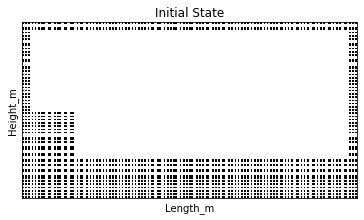

In [7]:
# initial state
plt.title("Initial State")
plt.xlabel('Length_m')
plt.ylabel('Height_m')
plt.xticks([])
plt.yticks([])
plt.imshow(matrix_list[0],cmap="gray")
print(matrix_list[0].shape)

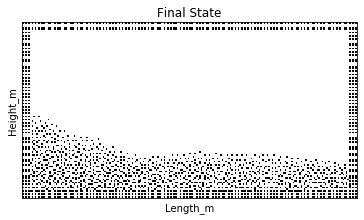

In [8]:
# final state
plt.title("Final State")
plt.xlabel('Length_m')
plt.ylabel('Height_m')
plt.xticks([])
plt.yticks([])
plt.imshow(matrix_list[-1],cmap="gray")

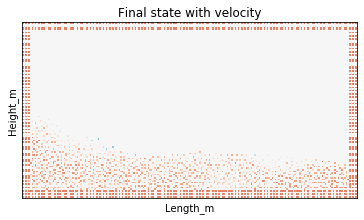

In [9]:
# final state with velocity
plt.title("Final state with velocity")
plt.xlabel('Length_m')
plt.ylabel('Height_m')
plt.xticks([])
plt.yticks([])
plt.imshow(matrix_vel_list[-1], cmap='RdBu', vmin=-1, vmax=3)

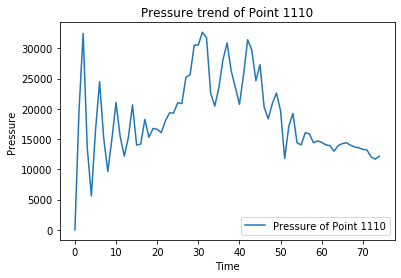

In [10]:
# please enter a number of a point to get the pressure changing trend
plot_pressure(1110,pressure)

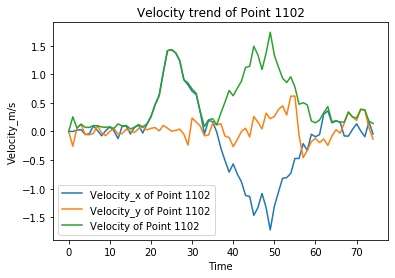

In [11]:
# please enter a number of a point to get the velocity changing treand
plot_velocity(1102,velocity_x,velocity_y, velocity)

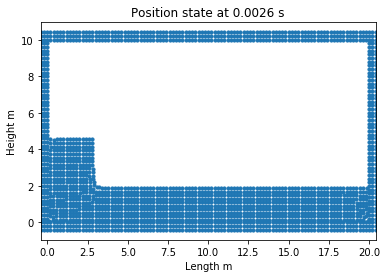

In [12]:
# please enter a step to see the state at dt*step s
plot_position(2, position_x, position_y)

In [13]:
ani = create_animation(matrix_list)
print('Preparing HTML (takes a little while...)')
HTML(ani.to_jshtml())

Finished plots for frames, building animation...
Preparing HTML (takes a little while...)


In [14]:
ani_1 = create_animation_vel(matrix_vel_list)
print('Preparing HTML (takes a little while...)')
HTML(ani_1.to_jshtml())

Finished plots for frames, building animation...
Preparing HTML (takes a little while...)


In [15]:
# find crest point
crest_index_x = np.zeros([num_file])
crest_index_y = np.zeros([num_file])
for i in range (0,num_file):
    matrix_state = matrix_list[i]
    new_position_y = matrix_state[6:,5:-6]
    index_x,index_y = np.where(new_position_y == np.min(new_position_y))
    index_crest = np.where(index_x == np.min(index_x))
    crest_x = np.zeros([index_crest[0].shape[0]])
    crest_y = np.zeros([index_crest[0].shape[0]])
    for j in range(0, index_crest[0].shape[0]):
        crest_x[j] = index_x[index_crest[0][j]]
        crest_y[j] = index_y[index_crest[0][j]]
    crest_x_new = np.mean(crest_x)
    crest_y_new = np.mean(crest_y)
    crest_index_x[i] = 10.48 - (crest_x_new + 6)*0.1
    crest_index_y[i] = (crest_y_new + 5)*0.1


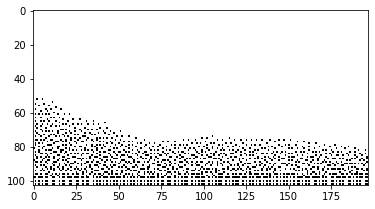

In [16]:
# show the shp without boundaries
plt.imshow(new_position_y, cmap='gray')

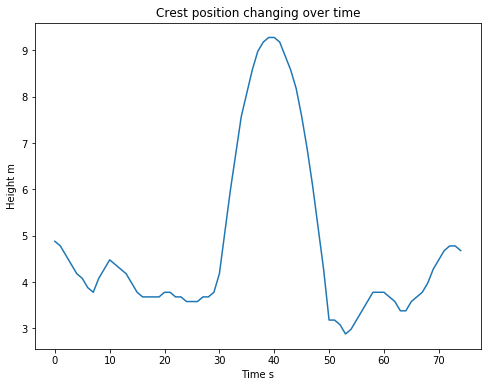

In [17]:
# plot crest function over time
plot_crest(num_file, crest_index_x)